<center><H1>Modelado con RNN para la predicción de la demanda de energía eléctrica</H1><center>

<center><img src="https://www.gstatic.com/devrel-devsite/prod/ve2848ad92313fddfcd40baeb58a2f663fe2fd55c371a714a6bb3e329e2b15223/tensorflow/images/lockup.svg"  height="80px" style="padding-bottom:5px;"  /></center>

<center><H2>Julio Waissman Vilanova</H2>

<table align="center">
      <td align="center"><a target="_blank" href="https://www.unison.mx">
            <img src="https://www.unison.mx/wp-content/themes/awaken/images/logo.png"  height="70px" style="padding-bottom:5px;"  /></a></td>  
      <td align="center"><a target="_blank" href="https://www.gob.mx/cenace">
            <img src="https://universidad.cenace.gob.mx/pluginfile.php/244/block_html/content/CENACE-logo-completo.png" width="300" style="padding-bottom:5px;" /></a></td>
      <td align="center"><a target="_blank" href="https://colab.research.google.com/github/juliowaissman/rn-cenace/blob/main/rnn_GRNO.ipynb">
            <img src="https://i.ibb.co/2P3SLwK/colab.png"  style="padding-bottom:5px;" />Ejecuta en Google Colab</a></td>

</table>

In [ ]:
#!pip install plotly
#!pip install statsmodels

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics import tsaplots

from sklearn.preprocessing import StandardScaler

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

import plotly.express as px
import plotly.graph_objects as go

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (15,7)

## 1. Introducción

En esta libreta vamos a ver como utilizar los modelos RNN (en particular con LSTMs y con GRUs) para la predicción de la demanda de energía eléctrica en la Gerencia Regional Noroeste. Le agradecemos a Jesús las facilidades para poder trabajar con la serie de tiempo.

Como en libretas pasada, ya habíamos visto la descarga y limpieza de los datos, en esta vamos a empezar guardando los datos y revisando algunas propiedades de éstos vistos como una serie de tiempo.

Empecemos por cargar los datos:

In [3]:
url = "https://github.com/juliowaissman/curso-ml-cenace/raw/main/datos/Dataset_GCRNO_05052021.xlsx"

df = pd.read_excel(url, sheet_name='Datos')

df_horario = df.melt(
    id_vars= ['FECHA'],
    value_vars= [f'DEM_GCRNO_H{i}' for i in range(24)],
    var_name="Hora",
    value_name="Demanda"
).replace(
    {f'DEM_GCRNO_H{i}': i for i in range(24)}
)

df_horario.index = df_horario.FECHA + pd.to_timedelta(df_horario.Hora, unit='h')
df_horario.sort_index(inplace=True)
df_horario.drop(columns=['FECHA', 'Hora'], inplace=True)
df_horario = df_horario.asfreq('H', method='pad')
df_horario["Fecha"] = df_horario.index

fig = px.line(df_horario, x="Fecha", y="Demanda", title='Demanda de energía GRNO')
fig.show()

Algo que no habíamos realizado es el revisar las propiedades de ésta serie de tiempo. Lo primero que vamos a hacer es descomponer la serie en su parte de *tendencia*, *Estacionalidad* y *residuos*, para tener una mejor visión de como se comporta la serie:

In [4]:
decompuesta = sm.tsa.seasonal_decompose(df_horario.Demanda)

fig = px.line(x=decompuesta.trend.index, y=decompuesta.trend, title='Tendencia')
fig.show()

fig = px.line(x=decompuesta.seasonal.index, y=decompuesta.seasonal, title='Estacionalidad')
fig.show()

fig = px.line(x=decompuesta.resid.index, y=decompuesta.resid, title='Residuos')
fig.show()

Otro análisis importante es el de autocorrelación. Veamos como funciona:

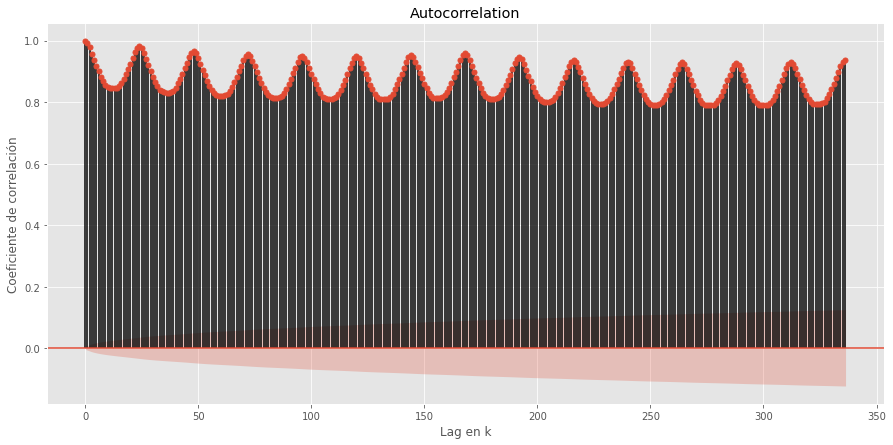

In [8]:
fig = tsaplots.plot_acf(df_horario.Demanda, lags=24*14)

plt.xlabel("Lag en k")
plt.ylabel("Coeficiente de correlación")
plt.show()

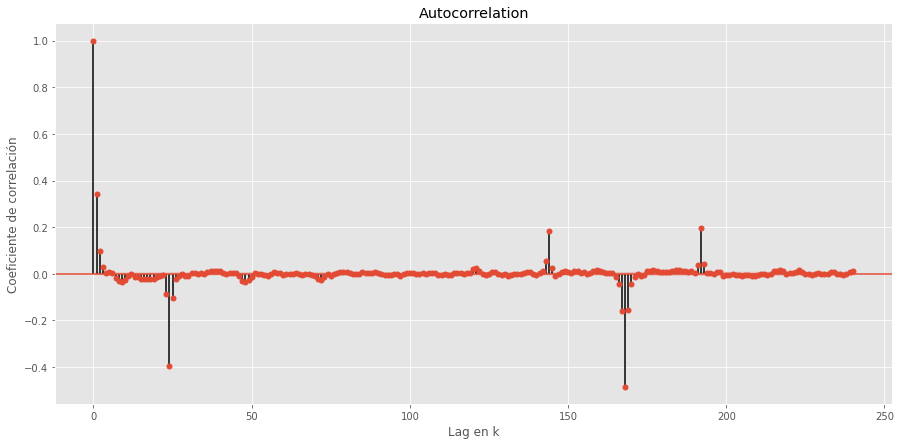

In [14]:
a = df_horario.Demanda.diff()[1:]
b = a.diff(24)[24:]
c = b.diff(24*7)[24*7:]
fig = tsaplots.plot_acf(c, lags=24*10)

plt.xlabel("Lag en k")
plt.ylabel("Coeficiente de correlación")
plt.show()

## 2. Usando RNN en arquitectura muchos-a-uno 


Vamos a hacer una RNN simple, en la cual, a partir deuna serie, vamos a recuperar un solo dato final (una hora en adelanto) y probar que tan bien funciona en relación a una red densa, antes de ver una red más complicada.

### 2.1 Creando las bases de entrenamiento

Primero seleccionemos los datos de entrenamiento y prueba.

In [17]:
df_train = df_horario[df_horario.index.year < 2021]
df_test = df_horario[df_horario.index.year == 2021]

serie_train = df_train.Demanda.values.reshape(-1,1)
serie_test = df_test.Demanda.values.reshape(-1,1)

(serie_train.shape, serie_test.shape)

((122736, 1), (2976, 1))

Debido al algoritmo de B-prop a través del tiempo, las RNN son muy sensibles a los valores de los datos de entrada (en particular las LSTMs) por lo que es importante normalizar los datos. Notese que vamos a ajustar el `scaler` con los datos de entrenamiento, y se usa el mismo para ajustar los datos de prueba.

In [18]:
scaler = StandardScaler().fit(serie_train)
x_train = scaler.transform(serie_train)
x_test = scaler.transform(serie_test)

In [22]:
x_test.mean()

-0.18357644375262405

Y ahora vamos a generar los `tf.dataset` que vamos a usar en entrenamiento y validación

In [52]:
# Algunos parámetros para establecer por nosotos

horizonte = 7 * 24  # 7 días (a modificar, con todo y comentario)
paso = 1  #  Por el momento predecir la 12 ava hora siguiente
batch_size = 31 * 24  #  Tamaño del minibatch del aprendizaje

split_train = int(0.8 * x_train.shape[0])  #  Vamos a usar 10% de los datos para validación

dataset_train = keras.preprocessing.timeseries_dataset_from_array(
    x_train[:split_train - horizonte - paso + 1,:],
    x_train[horizonte + paso - 1:split_train,:].ravel(),
    sequence_length=horizonte,
    sampling_rate=1,
    batch_size=batch_size,
)

dataset_val = keras.preprocessing.timeseries_dataset_from_array(
    x_train[split_train - horizonte - paso + 1: - horizonte - paso + 1,:],
    x_train[split_train:,:].ravel(),
    sequence_length=horizonte,
    sampling_rate=1,
    batch_size=batch_size,
)

dataset_test = keras.preprocessing.timeseries_dataset_from_array(
    x_test,
    None,
    sequence_length=horizonte,
    sampling_rate=1,
    batch_size=batch_size,
)

Hagamos una prueba a ver si estamos bien

In [25]:
for batch in dataset_train.take(1):
    inputs, targets = batch

print(f"Shape de inputs: {inputs.shape}") 
print(f"Shape de targets: {targets.shape}") 

print(f"Entrada:\n{inputs[:5, -5:, 0]}")
print(f"Objetivos:\n{targets[:5]}")

Shape de inputs: (744, 168, 1)
Shape de targets: (744,)
Entrada:
[[-1.08484124 -1.06439858 -1.10017324 -1.20366422 -1.35570652]
 [-1.06439858 -1.10017324 -1.20366422 -1.35570652 -1.47452949]
 [-1.10017324 -1.20366422 -1.35570652 -1.47452949 -1.56141081]
 [-1.20366422 -1.35570652 -1.47452949 -1.56141081 -1.60101846]
 [-1.35570652 -1.47452949 -1.56141081 -1.60101846 -1.62146113]]
Objetivos:
[-1.47452949 -1.56141081 -1.60101846 -1.62146113 -1.65468045]


In [27]:
for batch in dataset_val.take(1):
    inputs, targets = batch
    
print(f"Entrada:\n{inputs[:5, -5:, 0]}")
print(f"Objetivos:\n{targets[:5]}")

Entrada:
[[-0.02182281 -0.14703411 -0.27096775 -0.34123941 -0.41406639]
 [-0.14703411 -0.27096775 -0.34123941 -0.41406639 -0.46261771]
 [-0.27096775 -0.34123941 -0.41406639 -0.46261771 -0.44984105]
 [-0.34123941 -0.41406639 -0.46261771 -0.44984105 -0.41662172]
 [-0.41406639 -0.46261771 -0.44984105 -0.41662172 -0.3565714 ]]
Objetivos:
[-0.46261771 -0.44984105 -0.41662172 -0.3565714  -0.27480075]


### 2.2 Haciendo un modelo de aprendizaje

Ahora vamos a definir nuestro modelo de aprendizaje uno muy sencillo y luego lo vamos complicando.

In [28]:
# Vamos ahora a definir el modelo en forma funcional

entradas = keras.layers.Input(shape=(horizonte, 1))
lstm = keras.layers.LSTM(64)(entradas)
salida = keras.layers.Dense(1)(lstm)

model = keras.Model(inputs=entradas, outputs=salida)

model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001), 
    loss="mae",
    metrics=["mse", "mape"]
)
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 168, 1)]          0         
_________________________________________________________________
lstm (LSTM)                  (None, 64)                16896     
_________________________________________________________________
dense (Dense)                (None, 1)                 65        
Total params: 16,961
Trainable params: 16,961
Non-trainable params: 0
_________________________________________________________________


Y ahora mandamos optimizar. En este caso vamos a agregar dos cositas nuevas: La detención prematura y estar guardando modelos cada tanto tiempo para asegurar que si algo pasa, podamos recuperar una versión de lo que hemos entrenado.

In [30]:
epochs=5

path_checkpoint = "model_checkpoint.h5"
modelckpt_callback = keras.callbacks.ModelCheckpoint(
    monitor="val_loss",
    filepath=path_checkpoint,
    verbose=1,
    save_weights_only=True,
    save_best_only=True,
)


es_callback = keras.callbacks.EarlyStopping(
    monitor="val_loss", 
    min_delta=0, 
    patience=5
)


history = model.fit(
    dataset_train,
    epochs=epochs,
    validation_data=dataset_val,
    callbacks=[es_callback, modelckpt_callback],
)

Epoch 1/5
132/132 [==============================] - 117s 887ms/step - loss: 0.2169 - mse: 0.0718 - mape: 260.9844 - val_loss: 0.2338 - val_mse: 0.0909 - val_mape: 188.5275

Epoch 00001: val_loss improved from inf to 0.23377, saving model to model_checkpoint.h5
Epoch 2/5
132/132 [==============================] - 115s 875ms/step - loss: 0.1376 - mse: 0.0311 - mape: 138.7904 - val_loss: 0.1232 - val_mse: 0.0283 - val_mape: 71.1173

Epoch 00002: val_loss improved from 0.23377 to 0.12319, saving model to model_checkpoint.h5
Epoch 3/5
132/132 [==============================] - 116s 876ms/step - loss: 0.1066 - mse: 0.0197 - mape: 93.6033 - val_loss: 0.1264 - val_mse: 0.0289 - val_mape: 96.0510

Epoch 00003: val_loss did not improve from 0.12319
Epoch 4/5
132/132 [==============================] - 113s 859ms/step - loss: 0.0964 - mse: 0.0167 - mape: 86.5703 - val_loss: 0.1029 - val_mse: 0.0198 - val_mape: 54.8355

Epoch 00004: val_loss improved from 0.12319 to 0.10292, saving model to model_

y vamos viendo que tan bien aprendió o no

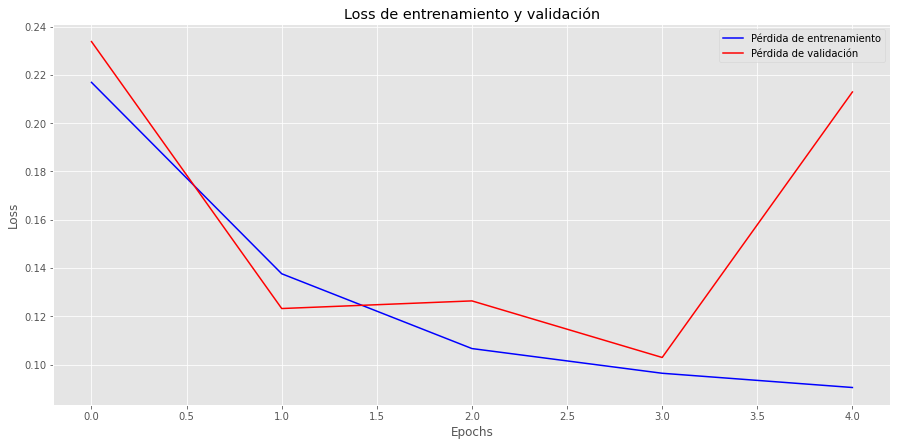

In [31]:
def visualize_loss(history, title):
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    epochs = range(len(loss))
    plt.figure()
    plt.plot(epochs, loss, "b", label="Pérdida de entrenamiento")
    plt.plot(epochs, val_loss, "r", label="Pérdida de validación")
    plt.title(title)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()


visualize_loss(history, "Loss de entrenamiento y validación")

### 2.3 Predicciones

Vamos a hacer lo mismo que ya hicimos en la red simple para simular. No es lo más eficiente (es un decir, el algoritmo es completamente ineficiente) pero es más o menos fácil de entender), veamos que es lo que pasa para la predicción.

In [46]:
y_est = model.predict(dataset_test)
x_test[horizonte + paso - 1:-horizonte - paso + 2,:].shape, y_est.shape

((2641, 1), (2641, 1))

In [49]:
df_prediccion = pd.DataFrame({
    "Fecha": df_test.Fecha[horizonte + paso - 1:-horizonte - paso + 2],
    "Real": scaler.inverse_transform(x_test[horizonte + paso - 1:-horizonte - paso + 2,:]).ravel(),
    "Estimados": scaler.inverse_transform(y_est).ravel()
})

fig = go.Figure()
fig.add_trace(go.Scatter(x=df_prediccion.Fecha, y=df_prediccion.Estimados, name="Estimada"))
fig.add_trace(go.Scatter(x=df_prediccion.Fecha, y=df_prediccion.Real, name="Real"))
fig.update_layout(title="Estimación de la demanda")
fig.show()

In [51]:
y_test = x_test.ravel()
y_real = y_test[horizonte + paso - 1 + 12:]
y_est_l = []

for ini in range(0, y_test.shape[0] - horizonte - 12, 24):
    x = y_test[ini:ini+horizonte]
    for inc in range(36):
        y = float(model.predict(x.reshape(1, -1)))
        x = np.append(x[1:], y)
        if inc >= 12:
          y_est_l.append(y)

y_est = np.array(y_est_l)

In [65]:
y_test[horizonte + paso - 1 + 12:].shape, y_est[:-12].shape, 

((2796,), (2796,))

In [66]:
df_estimacion = pd.DataFrame({
    "Fecha": df_test.index[horizonte + paso - 1:-12],
    "Real":  y_test[horizonte + paso - 1 + 12:],
    "Estimado": y_est[:-12]
})

fig = go.Figure()
fig.add_trace(go.Scatter(x=df_estimacion.Fecha, y=df_estimacion.Estimado, name="Estimada"))
fig.add_trace(go.Scatter(x=df_estimacion.Fecha, y=df_estimacion.Real, name="Real"))
fig.update_layout(title="Estimación de la demanda")
fig.show()

In [ ]:
y_est2 = model.predict(y_test).ravel()

Ahora te toca a ti modificar la arquitectura o el aprendizaje para que haga una predicción aceptablemente buena.

## 3. Una red neuronal profunda LSTM

Vamos a probar ahora con una red profunda, por ejemplo:

In [ ]:
deep_model = keras.models.Sequential([
  keras.layers.LSTM(20, return_sequences=True, input_shape=[None, 1]),
  keras.layers.LSTM(20, return_sequences=True),   ###
  keras.layers.LSTM(20),
  keras.layers.Dense(1)  
])

deep_model.compile(
  loss="mse", 
  optimizer=keras.optimizers.Adam(learning_rate=0.0005),
  metrics=['mae', 'mape']
)

deep_model.summary()


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_3 (LSTM)                (None, None, 20)          1760      
_________________________________________________________________
lstm_4 (LSTM)                (None, None, 20)          3280      
_________________________________________________________________
lstm_5 (LSTM)                (None, 20)                3280      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 21        
Total params: 8,341
Trainable params: 8,341
Non-trainable params: 0
_________________________________________________________________


In [ ]:
epochs=80

path_checkpoint = "deep_model_checkpoint.h5"
modelckpt_callback = keras.callbacks.ModelCheckpoint(
    monitor="val_loss",
    filepath=path_checkpoint,
    verbose=1,
    save_weights_only=True,
    save_best_only=True,
)

es_callback = keras.callbacks.EarlyStopping(
    monitor="val_loss", 
    min_delta=0, 
    patience=5
)

history = deep_model.fit(
    dataset_train,
    epochs=epochs,
    validation_data=dataset_val,
    callbacks=[es_callback, modelckpt_callback],
)

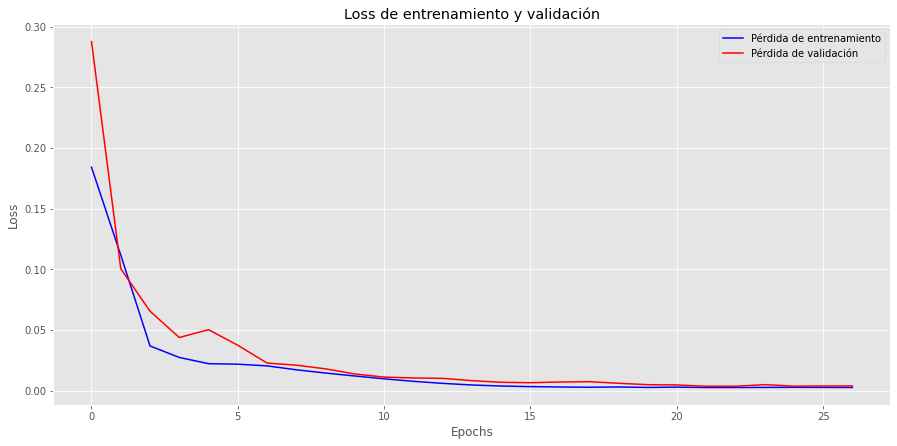

In [ ]:
visualize_loss(history, "Loss de entrenamiento y validación")

In [ ]:
y_test = x_test.ravel()
y_real = y_test[horizonte + 12:]
y_est_l = []

for ini in range(0, y_test.shape[0] - horizonte - 12, 24):
    x = y_test[ini:ini+horizonte]
    for inc in range(36):
        y = float(deep_model.predict(x.reshape(1, -1, 1)))
        x = np.append(x[1:], y)
        if inc >= 12:
            y_est_l.append(y)

y_est = np.array(y_est_l)

In [ ]:
(y_test[horizonte+12:].shape, y_est.shape)

((2880,), (2880,))

In [ ]:
df_estimacion = pd.DataFrame({
    "Fecha": df_test.index[horizonte+12:],
    "Real":  y_test[horizonte+12:],
    "Estimado": y_est
})

fig = go.Figure()
fig.add_trace(go.Scatter(x=df_estimacion.Fecha, y=df_estimacion.Estimado, name="Estimada"))
fig.add_trace(go.Scatter(x=df_estimacion.Fecha, y=df_estimacion.Real, name="Real"))
fig.update_layout(title="Estimación de la demanda")
fig.show()

In [ ]:
y_est2 = deep_model.predict(dataset_test)


In [ ]:
print(y_est2.shape[0]- x_test.shape[0])


-83


In [ ]:

fig = go.Figure()
fig.add_trace(go.Scatter(x=df_test.index, y=x_test.ravel(), name="Real"))
fig.add_trace(go.Scatter(x=df_test.index[83:], y=y_est2.ravel(), name="Estimada"))
fig.update_layout(title="Estimación de la demanda")
fig.show()